In [1]:
import sys
import os
import glob
sys.path.append(os.environ["BUILD_WORKSPACE_DIRECTORY"])
import json
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import torch
import cv2
import copy
import pandas as pd
import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()

DATA_DIR = "/home/gabriel/data/alphapose/synthetic"
datasets = [dataset for dataset in os.listdir(DATA_DIR)]
MODEL_PATH = "/home/gabriel/models/alphapose/3d_human_pose_shape_estimation/pretrained_w_cam.pth"
INFERENCE_DIR = "/home/gabriel/inference/alphapose"
ALPHA_POSE_2D_PATH = os.path.join(INFERENCE_DIR, "alphapose_inference")
ALPHA_POSE_3D_PATH = os.path.join(INFERENCE_DIR, "alphapose_inference_3d")
AP_INF_JSON = "alphapose-results.json"
# 3D Skeleton
L_PAIR = [
    (15, 12), (12, 9), (9, 13), (13, 16),
    (16, 18), (18, 20), (20, 22), (9, 14),
    (14, 17), (17, 19), (19, 21), (21, 23),
    (9, 6), (6, 3), (3, 0), (0, 1),
    (1, 4), (4, 7), (7, 10), (0, 2),
    (2, 5), (5, 8), (8, 11),
]
DATASET_LIMIT_MAP = {
    "_uscold-laredo-dock01": {
        "xlim": [-2, 10],
        "ylim": [9, 83],
        "zlim": [-7, 2],
    },
}

In [2]:
def get_humans_for_image(pred_list: dict):
    """Get mapping of list of human prediction in an image"""
    img_human_map = {}
    for human in pred_list:
        img_name = human["image_id"]
        if img_name not in img_human_map:
            img_human_map[img_name] = []
        img_human_map[img_name].append(human)
    return img_human_map

In [3]:
def get_xyz_transl_joints(human: dict):
    all_transl = torch.tensor(human["transl"]).numpy()
    transl = all_transl.squeeze()
    xyz_preds = torch.tensor(human["pred_xyz_jts_24"])
    focal = np.array([1000, 1000])
    # x1y1wh
    bbox = human['crop_box']
    # x1x2y1y2
    bbox = [bbox[0], bbox[0] + bbox[2], bbox[1], bbox[1] + bbox[3]]
    
    transl[0] = transl[0] + ((bbox[0] + bbox[1]) / 2) * transl[2] / focal[0]
    transl[1] = transl[1] + ((bbox[2] + bbox[3]) / 2) * transl[2] / focal[1]
    transl[2] = transl[2] * 256 / (bbox[1] - bbox[0])
    
    xyz_preds = xyz_preds + transl
    xyz_preds = xyz_preds.numpy()
    return xyz_preds

In [4]:
def get_jointed_limbs(human: dict, l_pair=L_PAIR):
    xyz_pred = get_xyz_transl_joints(human)
    x = np.array([[xyz_pred[l[0], 0], xyz_pred[l[1], 0]] for l in l_pair])
    y = np.array([[xyz_pred[l[0], 1], xyz_pred[l[1], 1]] for l in l_pair])
    z = np.array([[xyz_pred[l[0], 2], xyz_pred[l[1], 2]] for l in l_pair])
    return x, y, z

In [8]:
def plot_interactive_3d_skeletons(humans: list, l_pair=L_PAIR, limits_dict = None):
    cmap = plt.get_cmap("rainbow")
    colors = [cmap(i) for i in np.linspace(0, 1, len(l_pair) + 2)]
    colors = [np.array((c[0], c[1], c[2])) for c in colors]
    data = []
    for human in humans:
        idx = human["idx"]
        x, y, z = get_jointed_limbs(human)
        for i, _ in enumerate(x):
            x_pair = x[i]
            y_pair = y[i]
            z_pair = z[i]
            data.append(
                go.Scatter3d(
                    name=f"Human {idx}, l{i}",
                    x=x_pair,
                    y=z_pair,
                    z=-y_pair,
                    mode='markers+lines',
                    marker=dict(
                        size=3,
                    ),
                )
            )
    fig = go.Figure(data=data)
    if limits_dict:
        fig.update_layout(
            scene = dict(
                xaxis = dict(range=limits_dict["xlim"]),
                yaxis = dict(range=limits_dict["ylim"]),
                zaxis = dict(range=limits_dict["zlim"])
            )
        )
    fig.show()

In [6]:
dataset = datasets[datasets.index("_uscold-laredo-dock01")]
print(dataset)
img_path = os.path.join(DATA_DIR, os.path.join(dataset, "rgb"))
with open(os.path.join(ALPHA_POSE_3D_PATH, os.path.join(dataset, AP_INF_JSON)), "r") as f:
    ap_inf_3d = json.load(f)
img_human_map = get_humans_for_image(ap_inf_3d)

_uscold-laredo-dock01


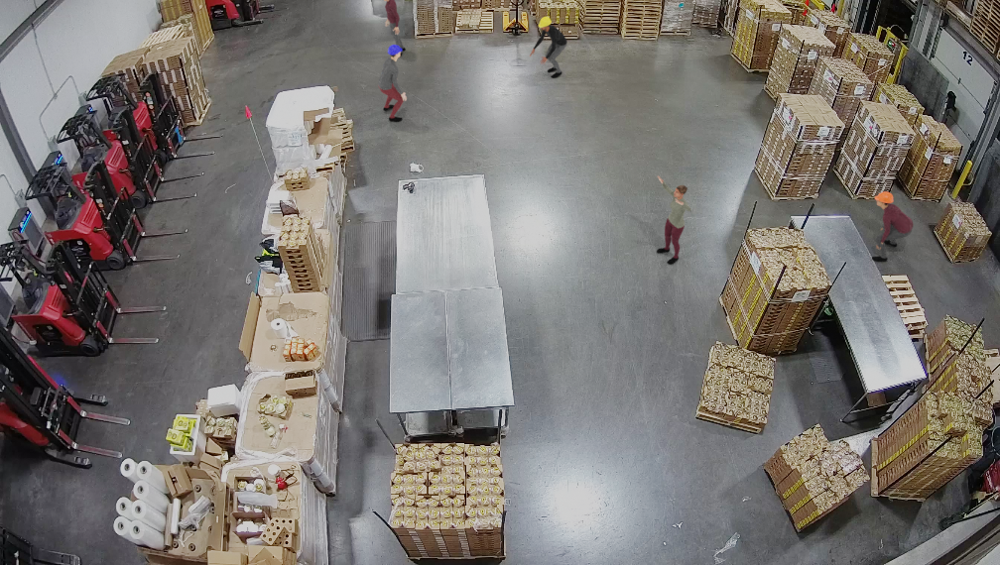

In [7]:
pred = ap_inf_3d[0]
img = Image.open(os.path.join(img_path, pred["image_id"]))
img.show()

In [35]:
mins = np.zeros((len(ap_inf_3d), 3))
maxs = np.zeros((len(ap_inf_3d), 3))
for i, human in enumerate(ap_inf_3d):
    idx = human["idx"]
    xyz_preds = get_xyz_transl_joints(human)
    mins[i] = np.min(xyz_preds, axis=0)
    maxs[i] = np.max(xyz_preds, axis=0)
print(f"MIN, {np.min(mins, axis=0)}")
print(f"MAX, {np.max(maxs, axis=0)}")

MIN, [-0.41960081 -0.82207114 10.00551987]
MAX, [ 8.74046612  5.56562662 82.1973114 ]


## TEST

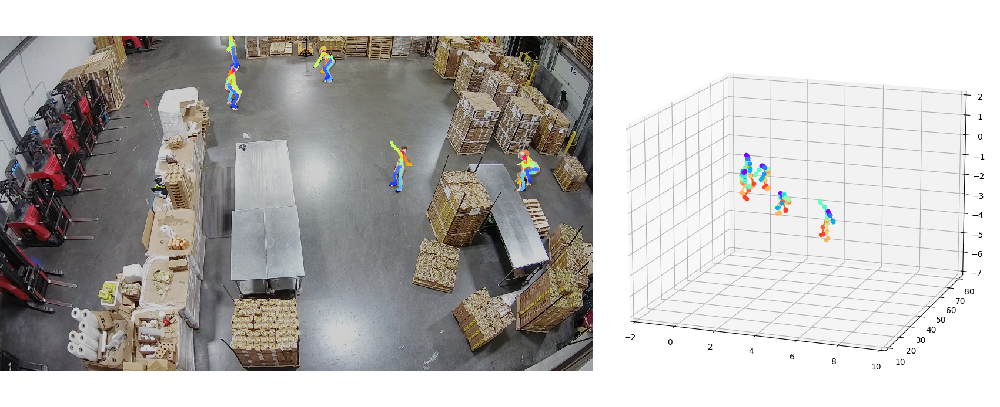

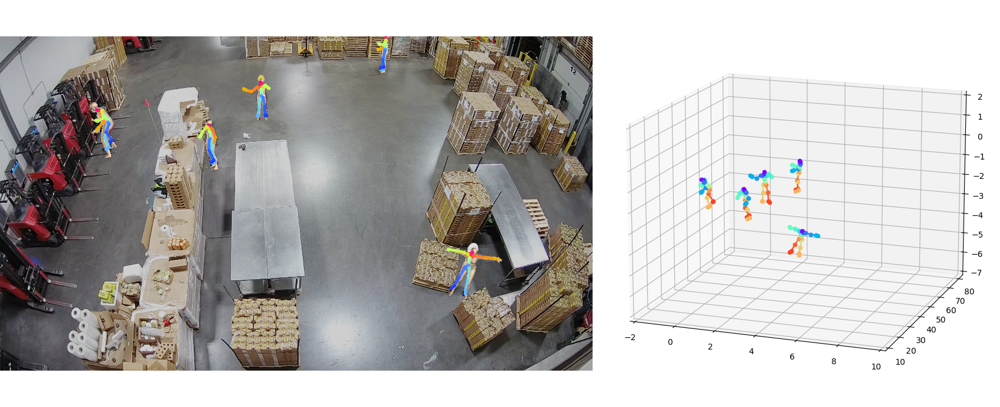

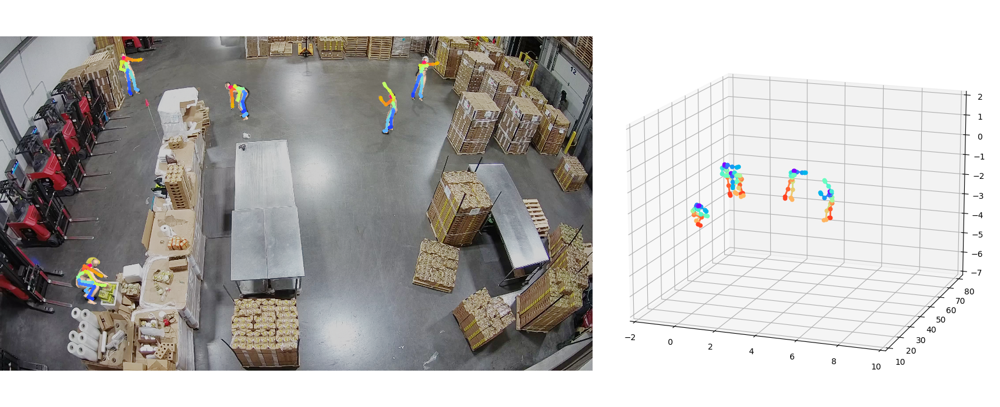

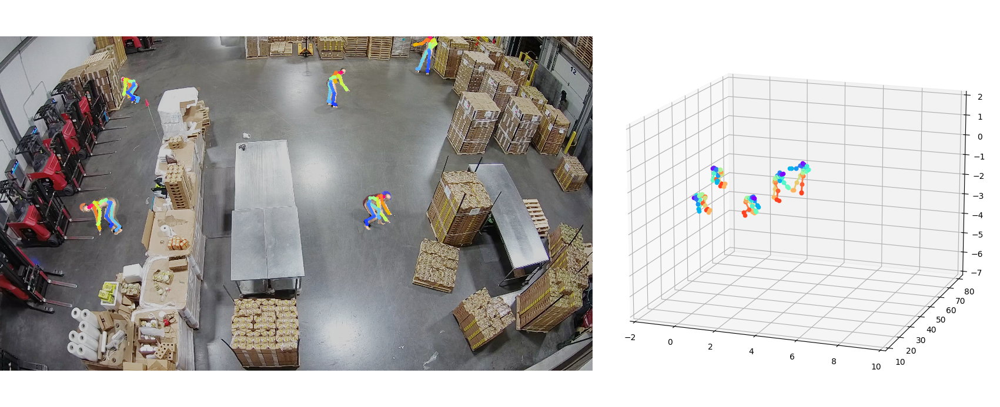

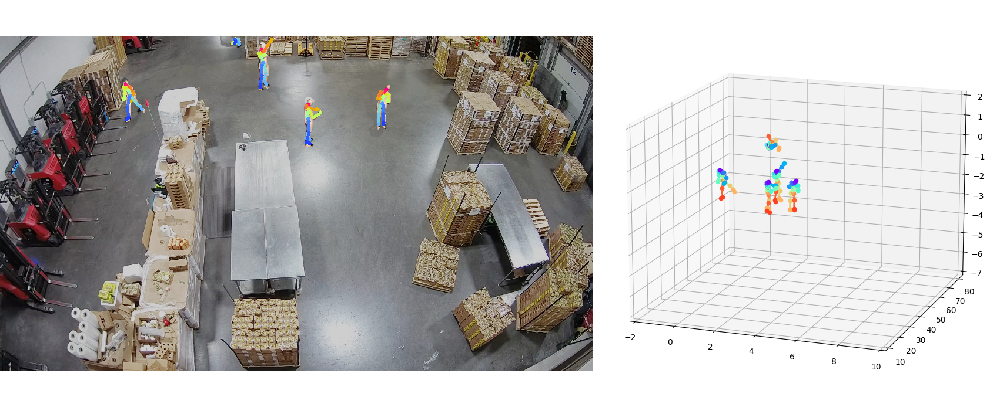

...

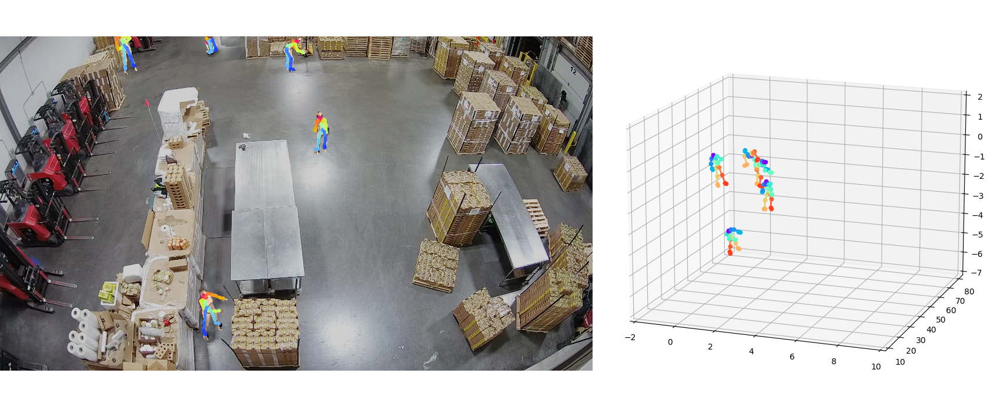

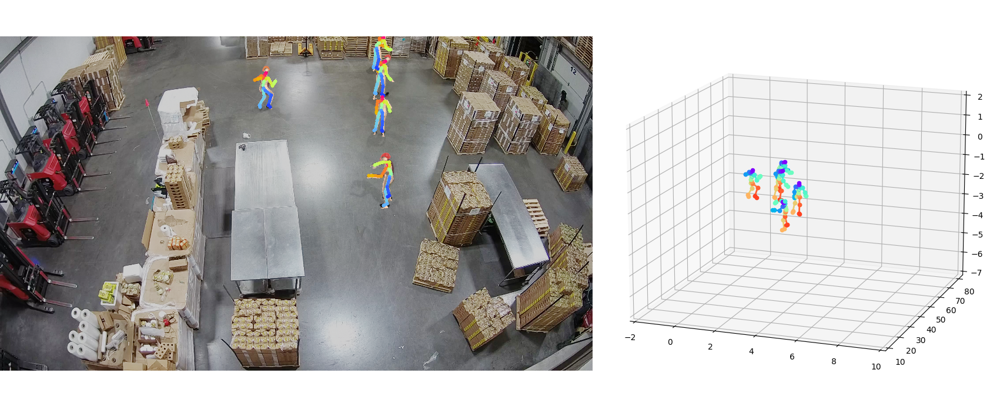

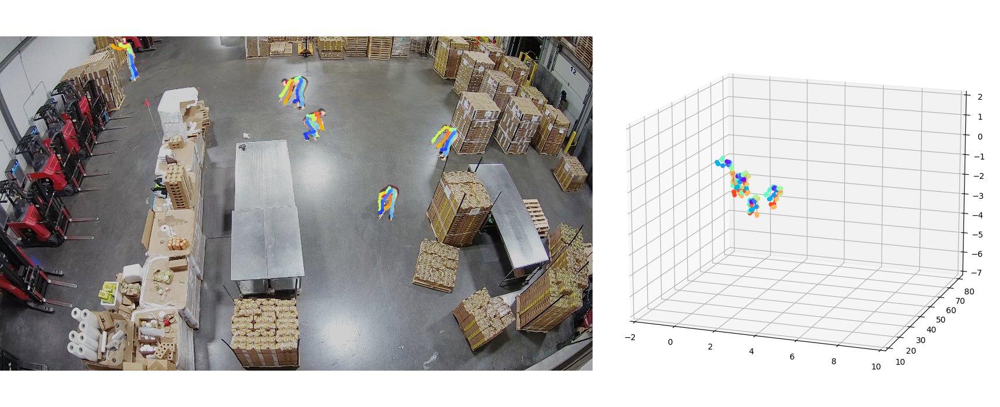

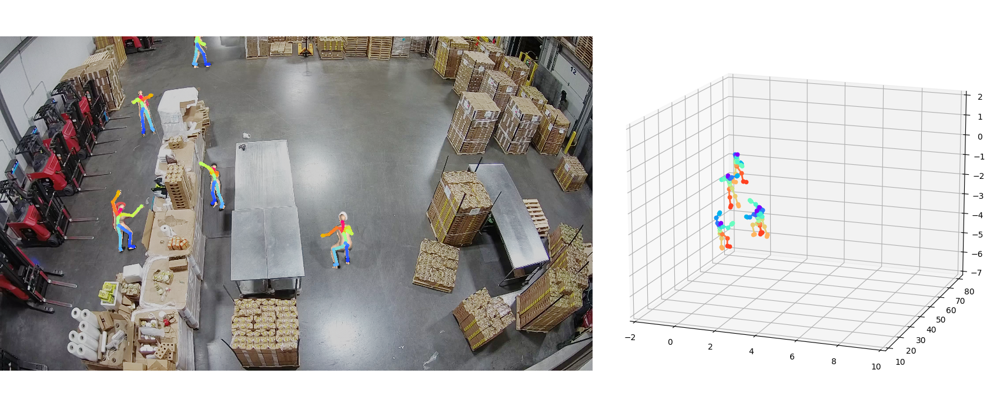

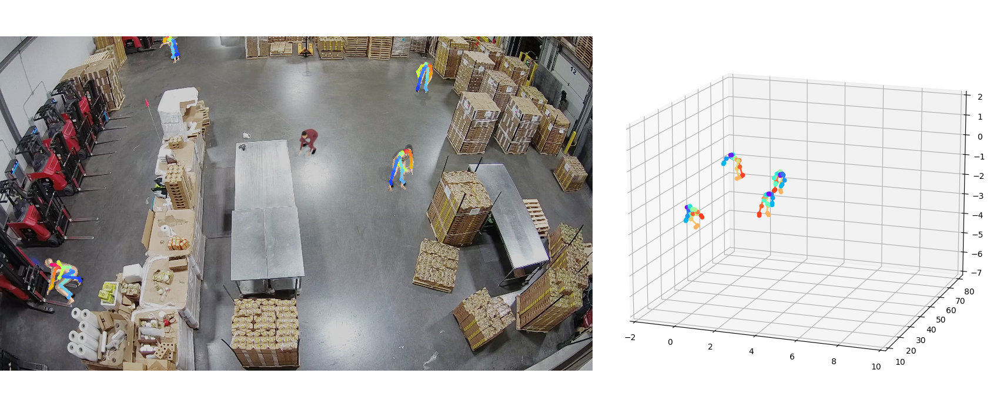

In [9]:
dataset = datasets[datasets.index("_test")]
img_path = os.path.join(DATA_DIR, os.path.join(dataset, "rgb"))
with open(os.path.join(ALPHA_POSE_3D_PATH, os.path.join(dataset, AP_INF_JSON)), "r") as f:
    ap_inf_3d_test = json.load(f)
img_human_map = get_humans_for_image(ap_inf_3d_test)
for img_name, humans in img_human_map.items():
    path = os.path.join(img_path, img_name)
    if not os.path.exists(path):
        continue
    img = Image.open(os.path.join(img_path, img_name))
    img.show()
    plot_interactive_3d_skeletons(humans)

In [45]:
plot_interactive_3d_skeletons(humans[5:6])

In [47]:
ap_inf_3d_test[0:1]

{'image_id': 'image.000999.rgb.png',
 'category_id': 1,
 'keypoints': [617.3526000976562,
  144.91575622558594,
  0.9752044081687927,
  619.6751098632812,
  149.33604431152344,
  0.9908193945884705,
  614.0940551757812,
  148.3444061279297,
  0.9868061542510986,
  618.3433227539062,
  140.43955993652344,
  0.9934152364730835,
  619.7265625,
  166.62782287597656,
  0.9815890192985535,
  608.0777587890625,
  163.97300720214844,
  0.9817662835121155,
  619.0245361328125,
  134.9705810546875,
  0.9898320436477661,
  619.4160766601562,
  182.5883331298828,
  0.9601045250892639,
  606.273193359375,
  178.0142822265625,
  0.9367091059684753,
  618.9795532226562,
  132.98703002929688,
  0.9898856282234192,
  618.7353515625,
  187.33706665039062,
  0.8608749508857727,
  602.3353881835938,
  181.3768310546875,
  0.919077455997467,
  620.8304443359375,
  123.4765396118164,
  0.9861319661140442,
  623.2447509765625,
  128.45028686523438,
  0.989749014377594,
  616.7822265625,
  126.83041381835938,